<a href="https://colab.research.google.com/github/Nimaalm/Nimaalm/blob/main/HW2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os, sys
from google.colab import drive
drive.mount('/content/mnt')
nb_path = '/content/notebooks'
os.symlink('/content/mnt/My Drive/Colab Notebooks', nb_path)
sys.path.insert(0, nb_path)

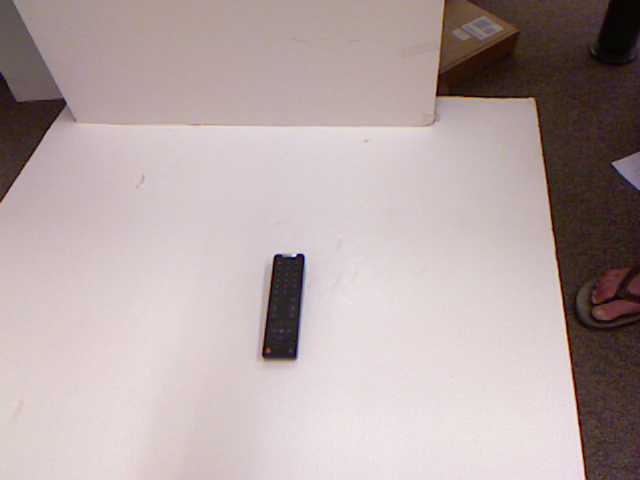

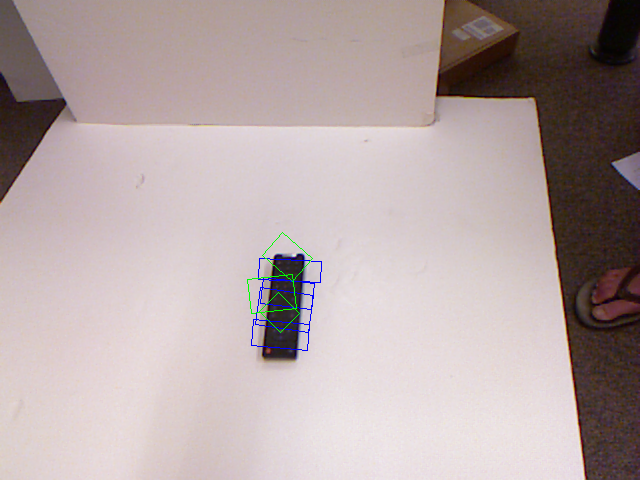

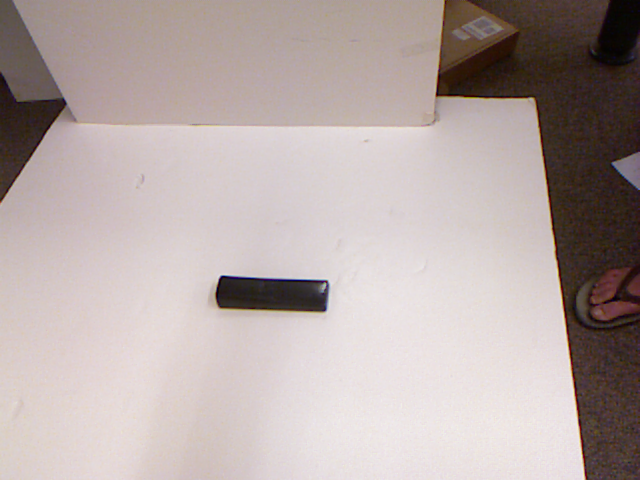

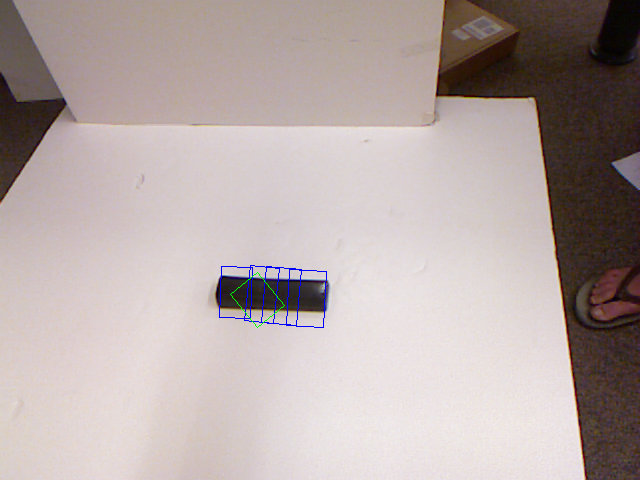

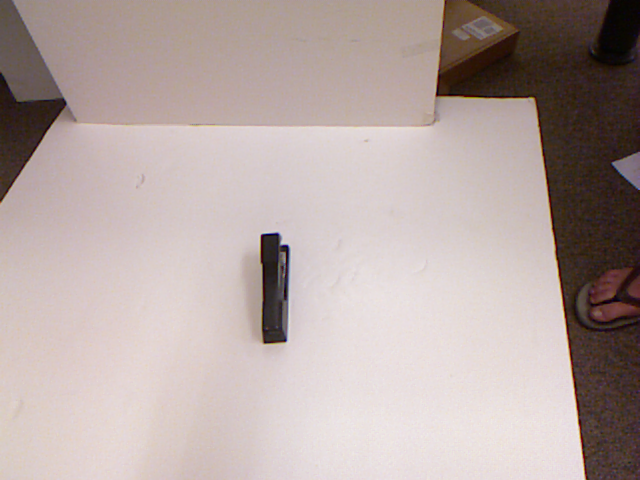

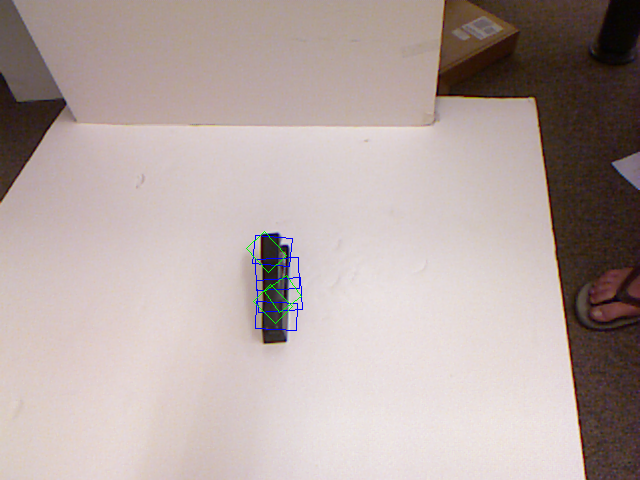

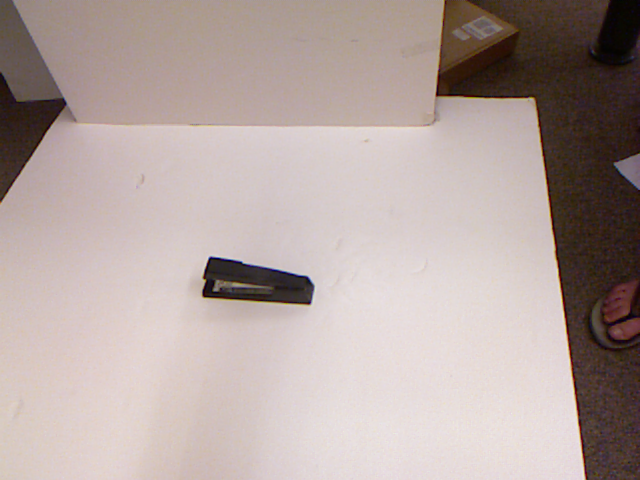

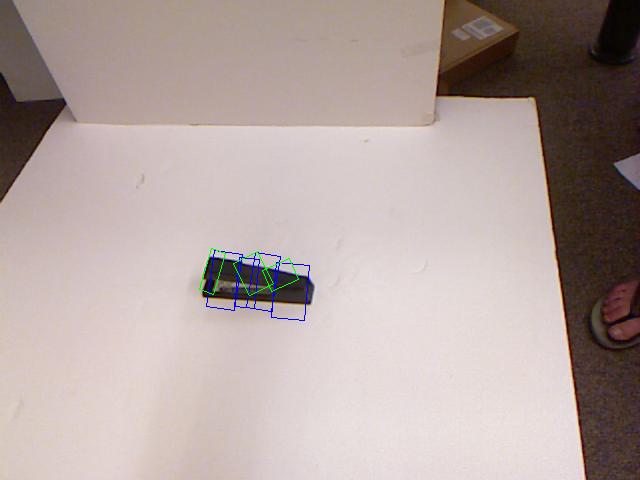

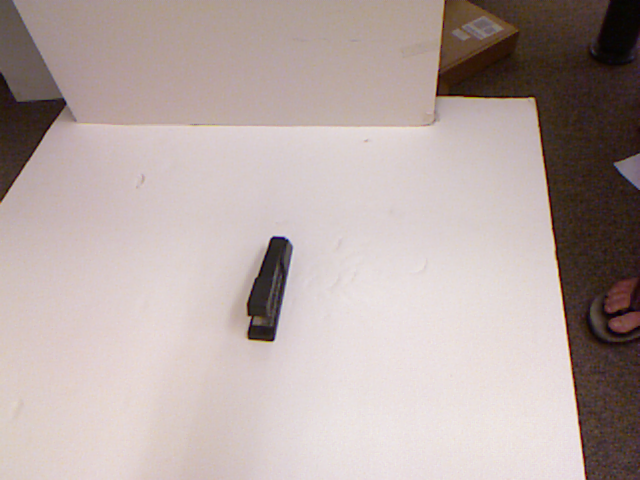

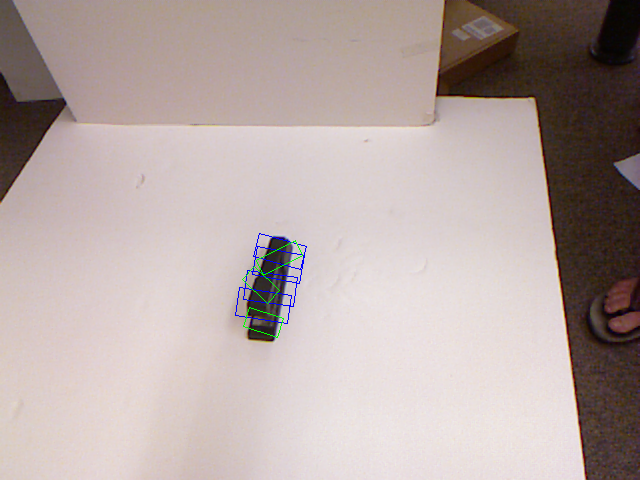

In [ ]:
# importing cv2  
import cv2  
from google.colab.patches import cv2_imshow
import pandas as pd

import numpy as np
import os


# Having the directory for the folder
directory = r'/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/'

def image_formulation(directory):
  path = []
  pos_path = []
  neg_path = []

  # Seperating all the postive and negative files 
  for filename in os.listdir(directory):

    if filename.endswith(".png") :
      path.append(os.path.join(directory, filename))

    elif filename.endswith("cpos.txt") :
      pos_path.append(os.path.join(directory, filename))

    elif filename.endswith("cneg.txt") :
      neg_path.append(os.path.join(directory, filename))

  # sorted the file path in order
  path = sorted(path[0:5])[0:5]
  #print('path',path[0:5])
  pos_path = sorted(pos_path)[0:5]
  #print('pos_path',pos_path[0:5])
  neg_path = sorted(neg_path)[0:5]
  #print('neg_path',neg_path[0:5])

  i = 0 
  z = 0 
  y = 0
  Number = []
  # Looping for all the postive and negtive 
  for i in range(len(path)):
    image = cv2.imread(path[i]) 
    cv2_imshow( image) 

    pos_location = pd.read_csv(pos_path[i],header = None, sep=" " ).dropna(axis='columns')

    #print('neg_path\n',pos_location)
    
    

    neg_location = pd.read_csv(neg_path[i],header = None, sep=" " ).dropna(axis='columns')
    #print('neg_path\n',neg_location)
    #print('Number ', i)
     
    if len(pos_location) != 0 :  
      p = 0 
      for z in range(4, len(pos_location)+1,4):
        
        Vertics = pos_location.iloc[abs(z-4):z].values
        #print('rrrrr',Vertics)
        image = cv2.polylines(image, np.int32([Vertics]) ,True ,(255,0,0),1 )
        p += 1 
      # print('P', Number)
      Number.append(p)
      

    #np.array([pos_location.iloc[0].values, pos_location.iloc[1].values])
      
    if len(neg_location) != 0 :
      for y in range(4, len(neg_location)+1,4):
        Vertics_neg = neg_location.iloc[abs(y-4):y].values
        #print('rrrrrneg',Vertics_neg)
        image = cv2.polylines(image, np.int32([Vertics_neg]) ,True ,(0, 255,0),1 )





      # Displaying the image  
    cv2_imshow( image)  
  return path,pos_path,neg_path, Number
  # Vertics_neg = neg_location.iloc[0:4].values
  # Vertics_neg

path,pos_path,neg_path,Number = image_formulation(directory)

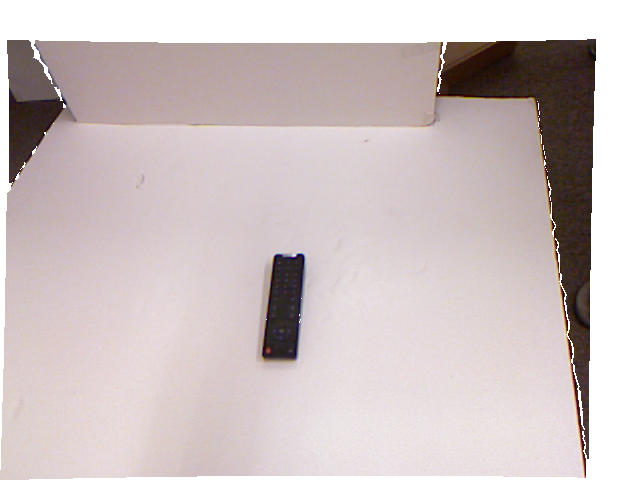

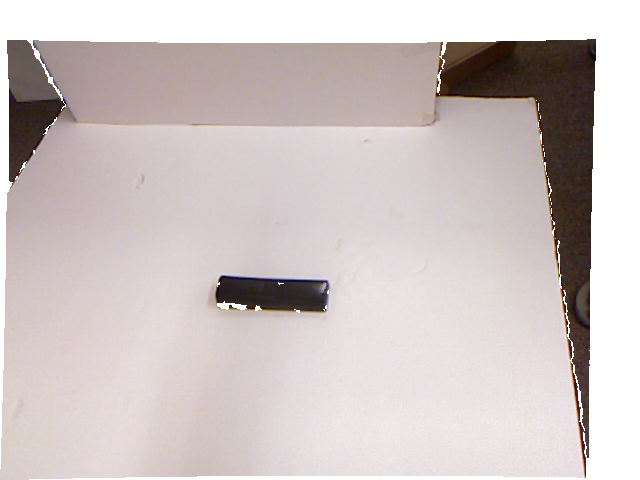

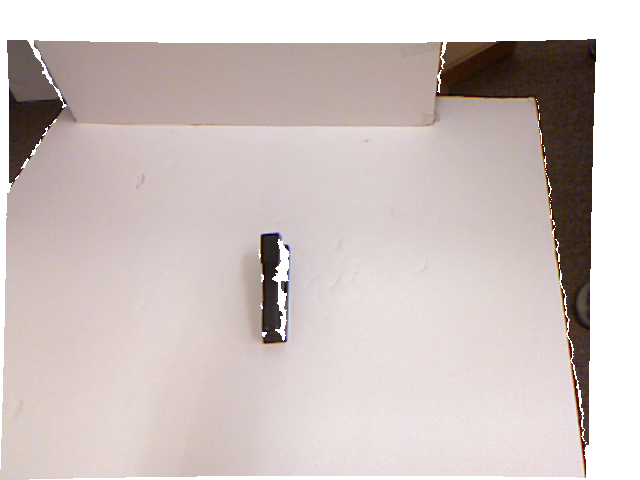

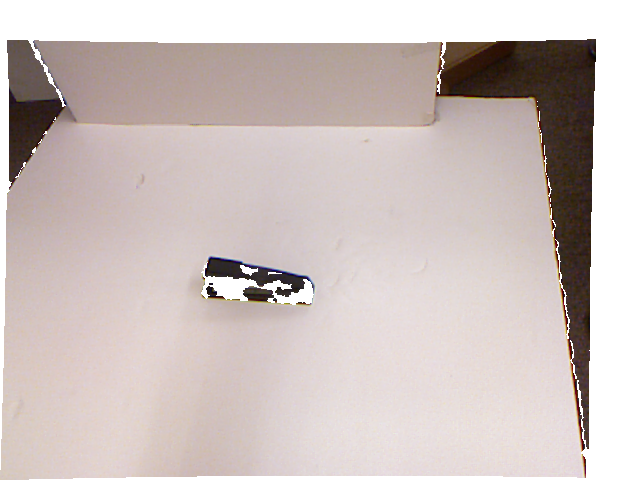

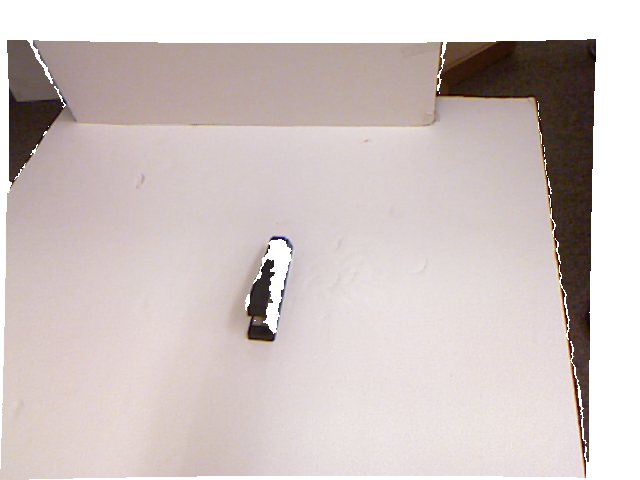

5


In [ ]:
import glob  


# define a pcd funcion to get the depth 
def from_pcd(cls, pcd_filename, size, index=None):
    img = np.zeros(size)

    with open(pcd_filename) as f:
        for l in f.readlines():
            ls = l.split()

            if len(ls) != 5:
                # Not a point line in the file.
                continue
            try:
                # Not a number, carry on.
                float(ls[0])
            except ValueError:
                continue

            i = int(ls[4])
            r = i // size[1]
            c = i % size[1]

            x = float(ls[0])
            y = float(ls[1])
            z = float(ls[2])

            img[r, c] = np.sqrt(x ** 2 + y ** 2 + z ** 2)

            y = np.expand_dims(img, axis=2)
      
    #print(np.shape(np.concatenate((cls, y), axis=2)))


    return np.concatenate((cls, y), axis=2)

# get all the x,y,z location 
#pcds = glob.glob(os.path.join('/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/',  'pcd0100.txt'))
pcds = glob.glob(os.path.join('/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/',  'pcd*[0-9].txt'))

#print('pcds',pcds)
pcds.sort()



#img_path = glob.glob(os.path.join('/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/',  '*100r.png'))
img_path = glob.glob(os.path.join('/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/',  '*r.png'))
img_path.sort()


size  = cv2.imread('/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/pcd0101r.png')[:,:,0].shape 



# Form the RGBD image append original image and calculated depth 
RGB_D = []


for pcd,img in zip(pcds[0:5],img_path[0:5]):
      image = cv2.imread(img) 
      di = from_pcd(image, pcd, (480, 640))
      RGB_D.append(di)

      #print(di)
      cv2_imshow( di)

print(len(RGB_D))





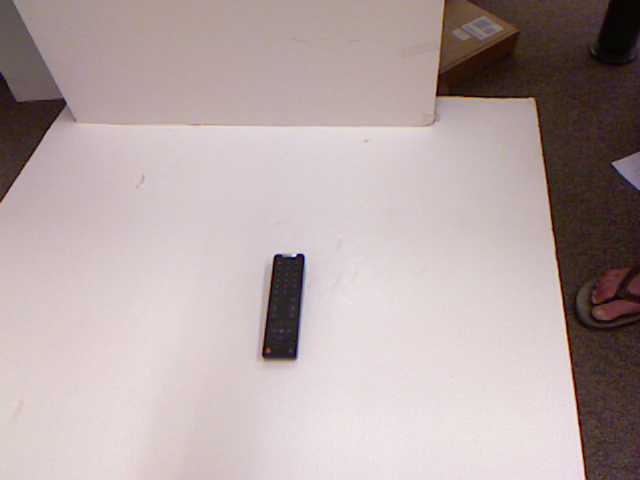

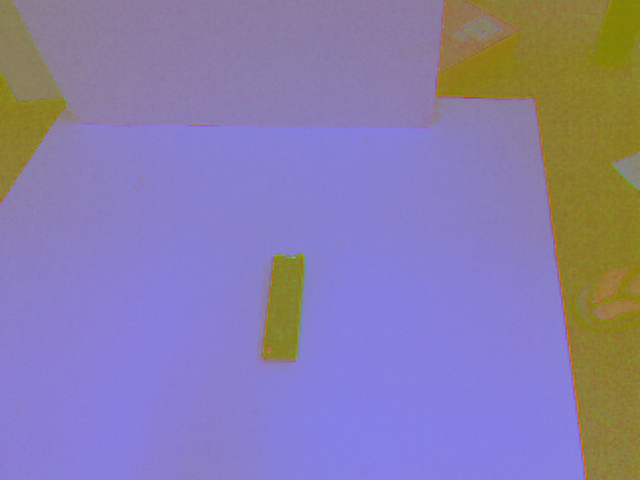

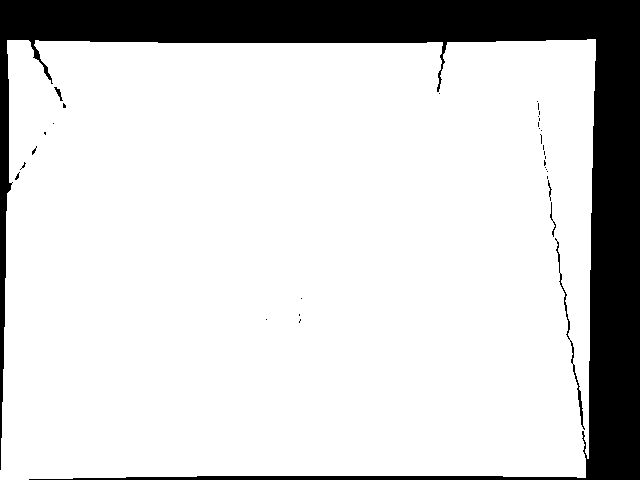

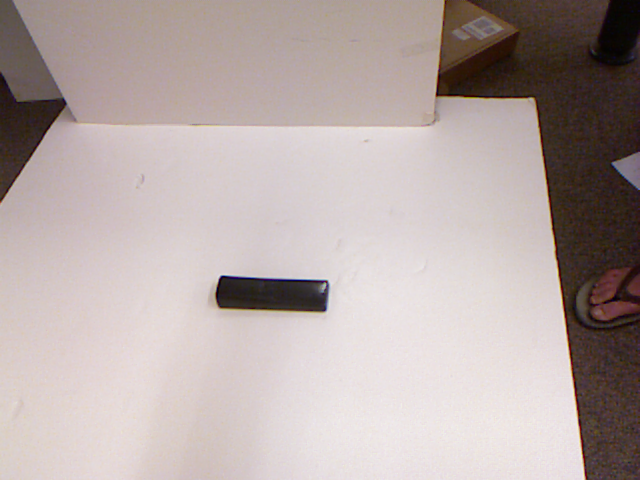

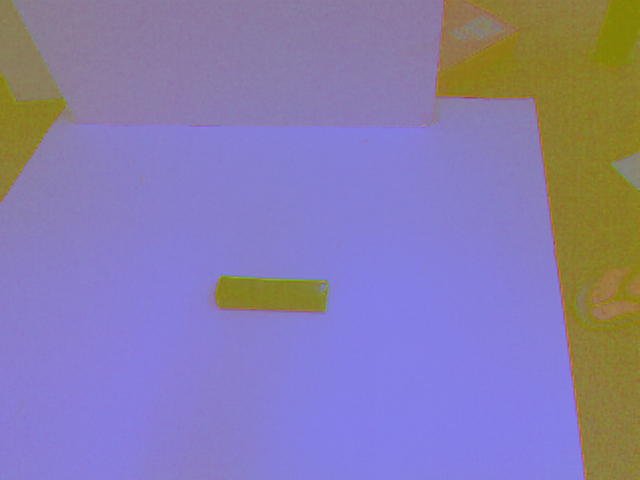

...

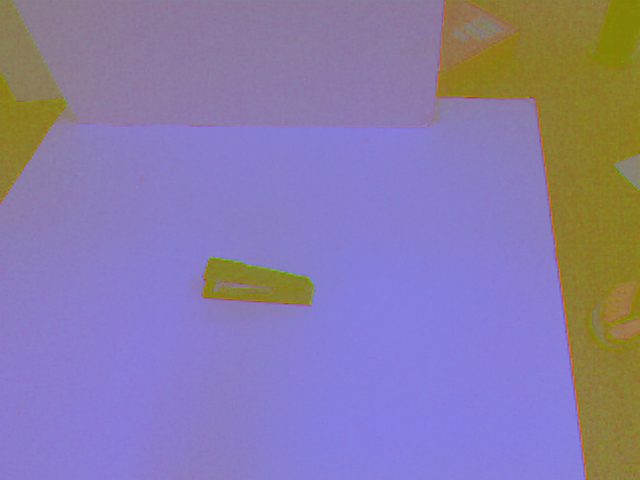

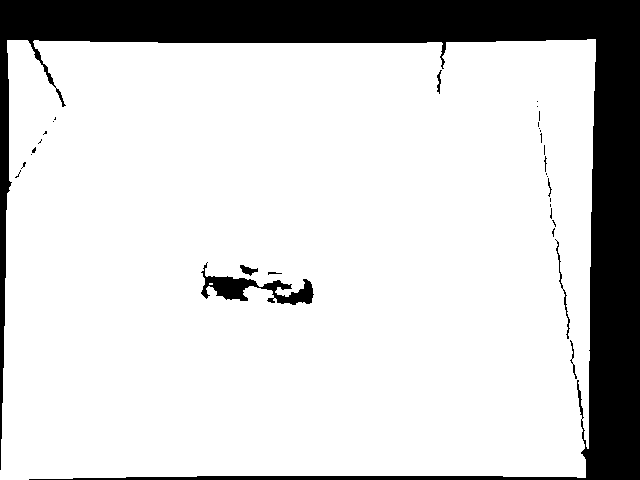

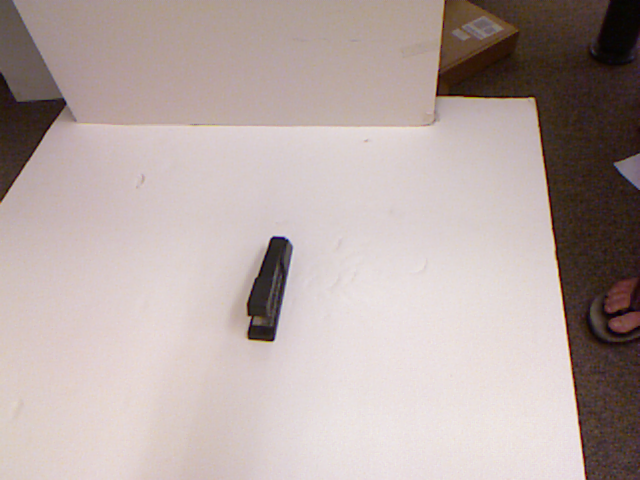

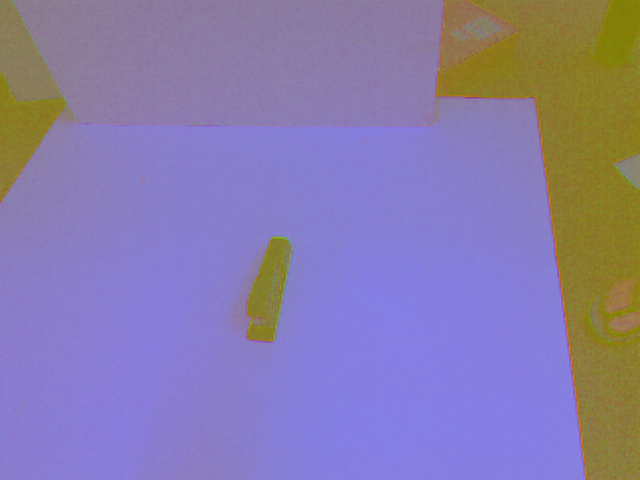

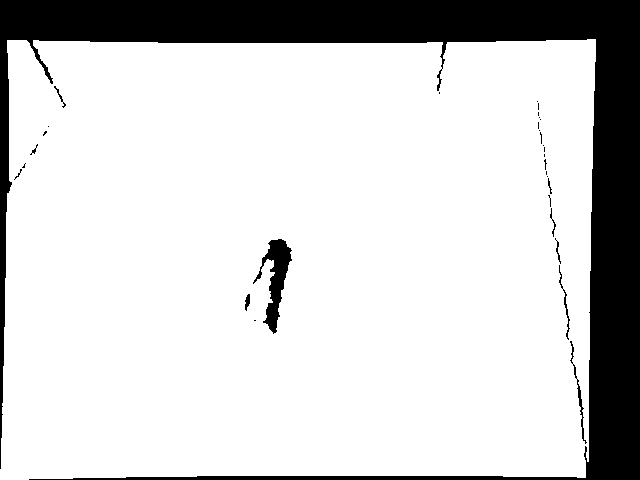

In [ ]:

q = 0 

for q in range(len(path)): 

  path[q] 


  # Load sample image
  img_bgr = cv2.imread(path[q])
  cv2_imshow(img_bgr)
  cv2.waitKey(0)




  # Convert from BGR to YUV
  img_yuv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2YUV)
  cv2_imshow(img_yuv)

  depth_current = RGB_D[q]
  


  cv2_imshow( depth_current[:, :,3])

path ['/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/pcd0100r.png']
pos_path ['/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/pcd0100cpos.txt']
RGB_D (480, 640, 4)


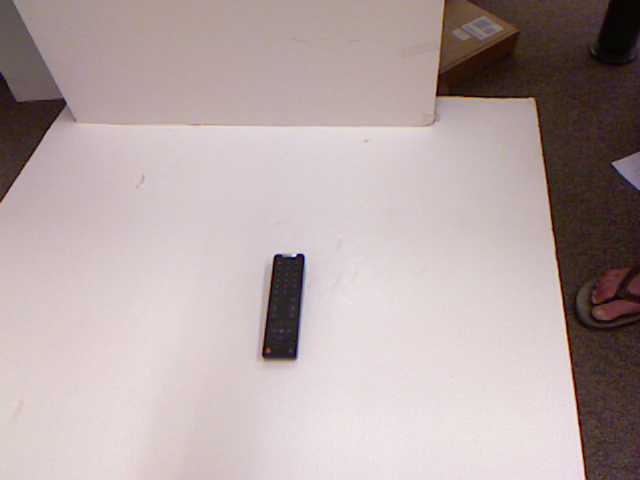

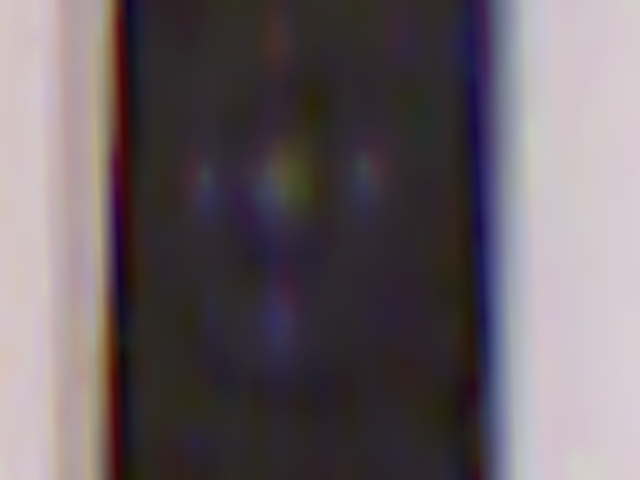

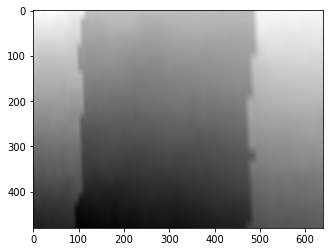

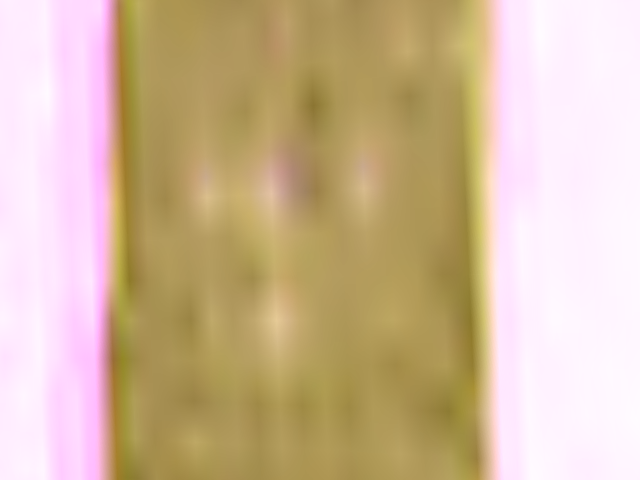

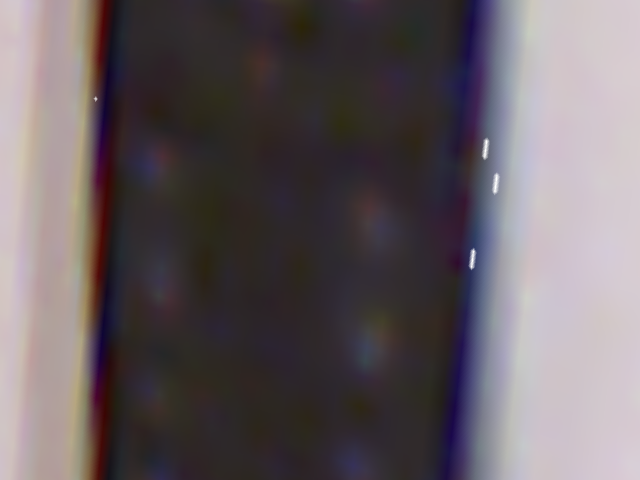

...

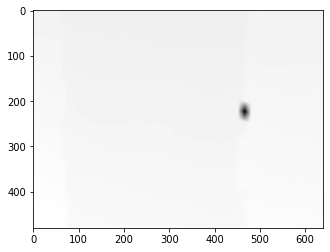

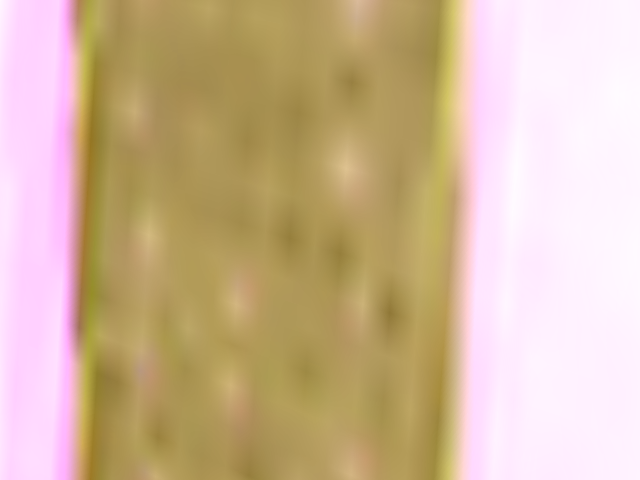

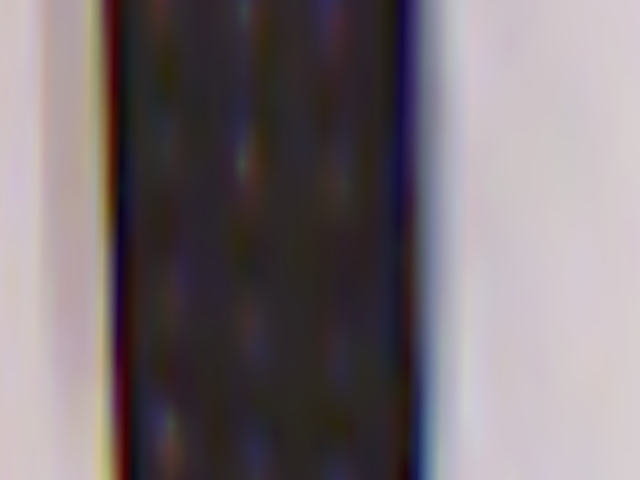

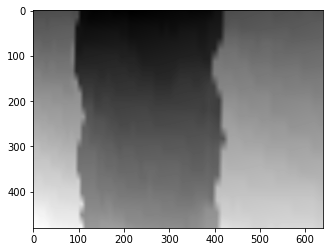

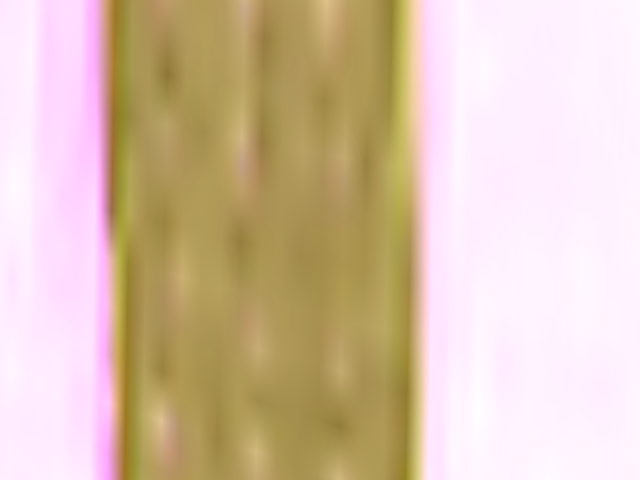

RGB_D (480, 640, 4)


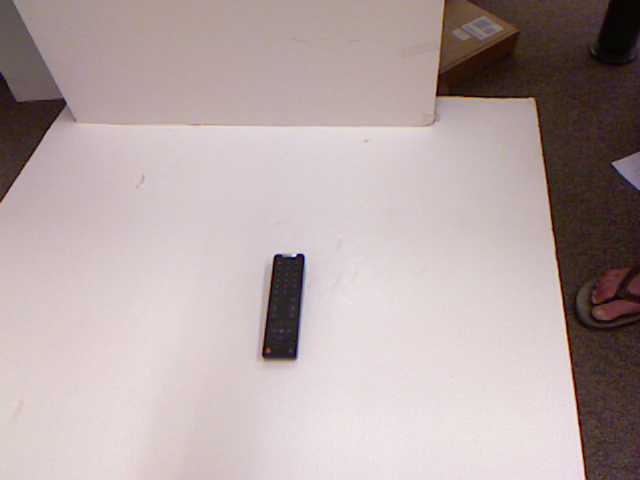

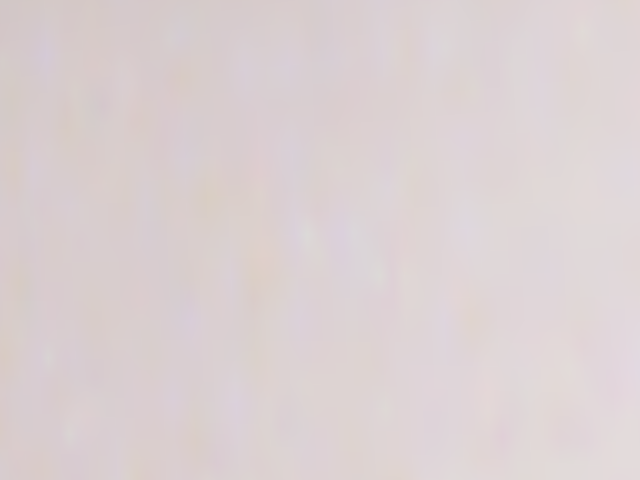

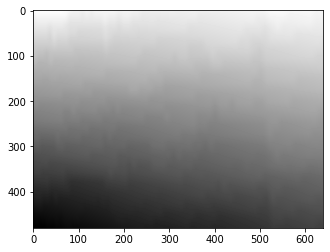

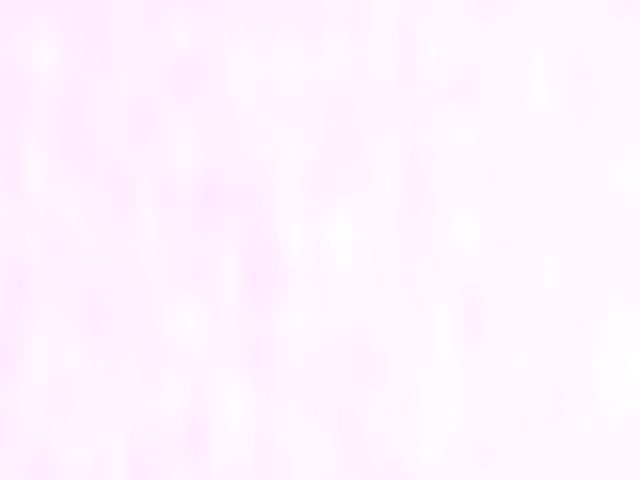

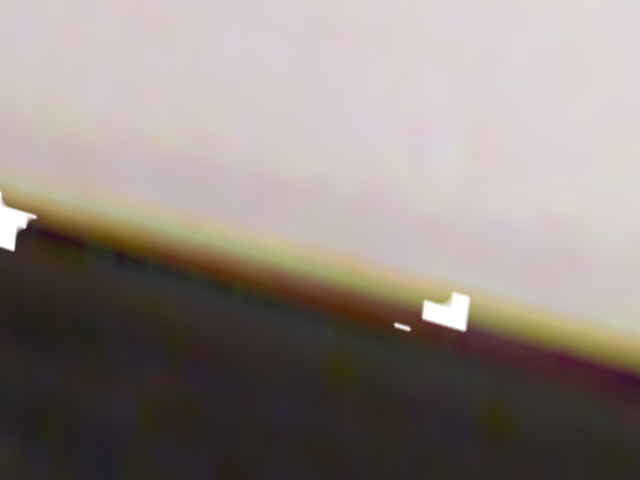

...

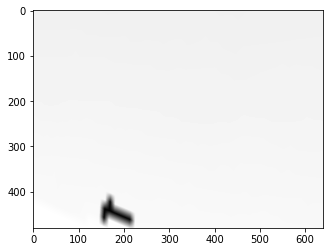

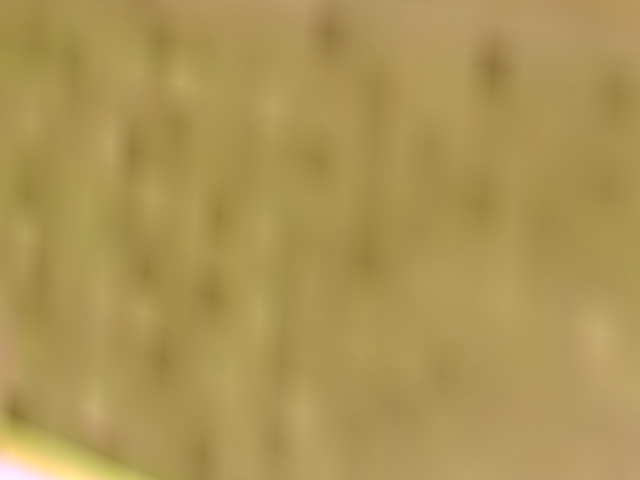

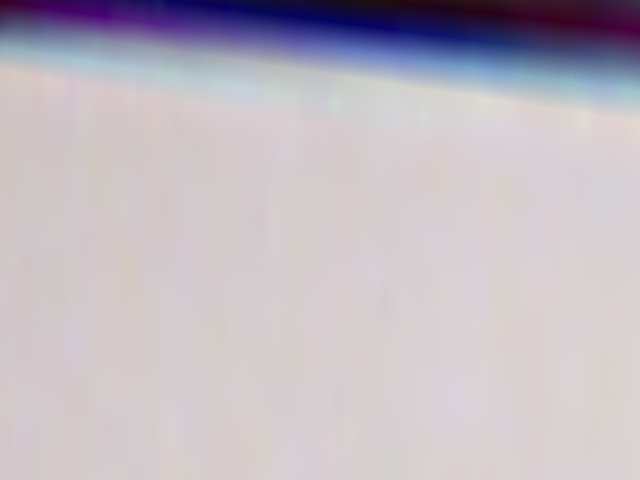

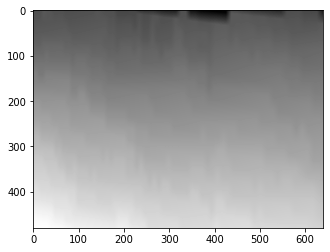

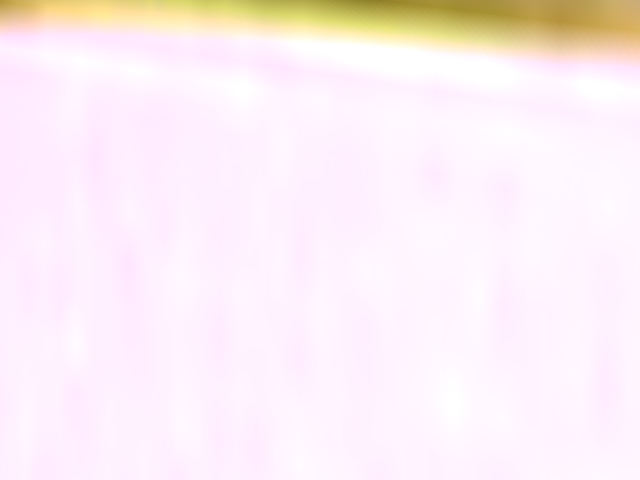

RGB_D (480, 640, 4)


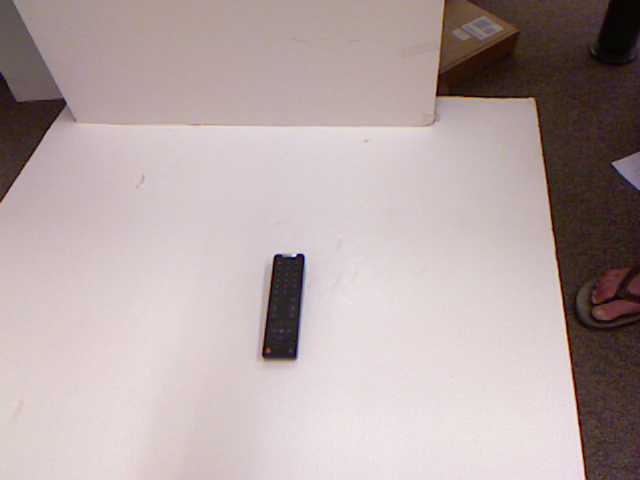

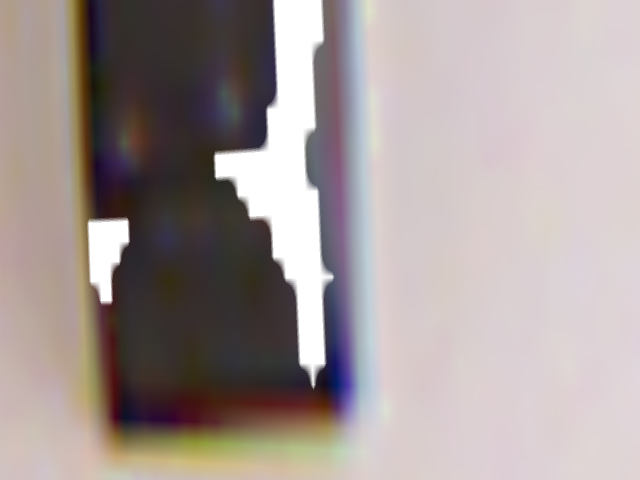

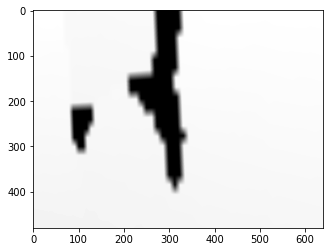

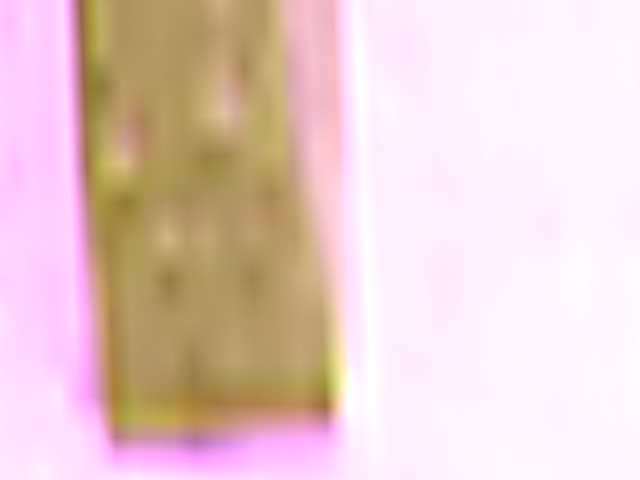

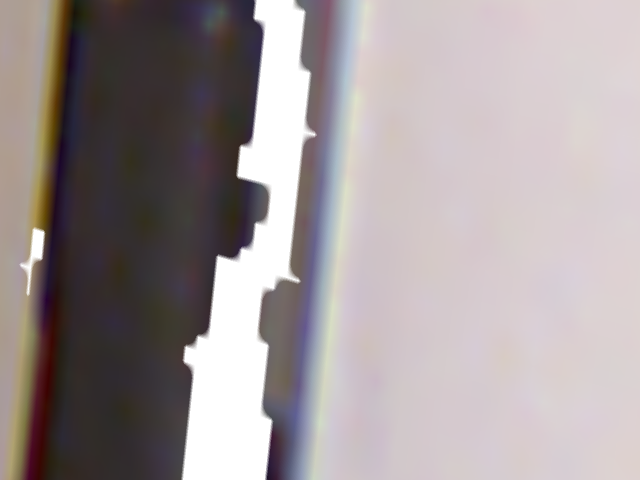

...

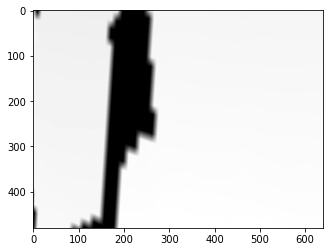

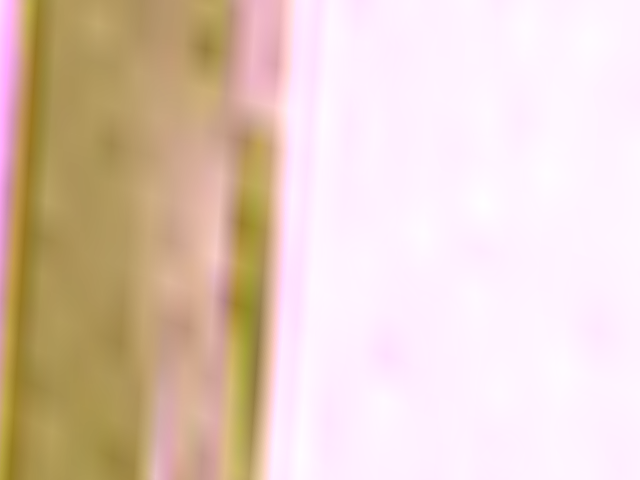

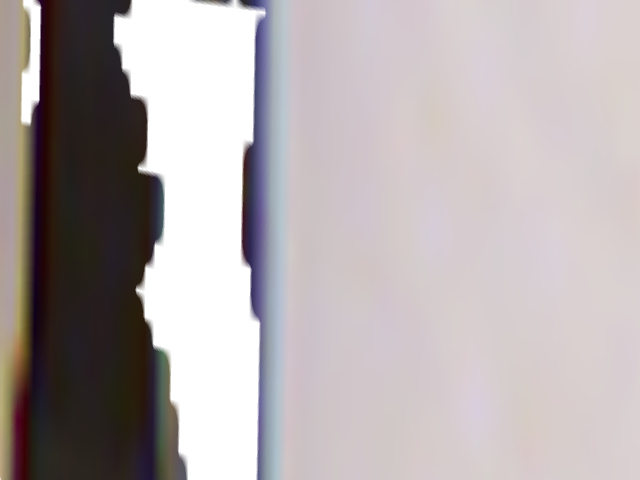

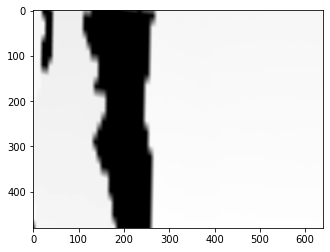

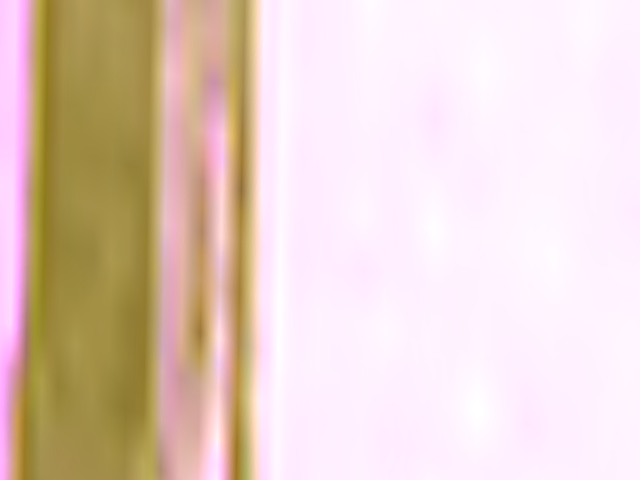

RGB_D (480, 640, 4)


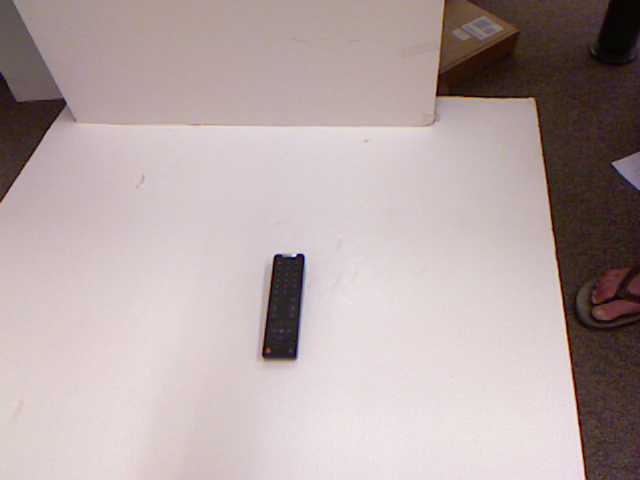

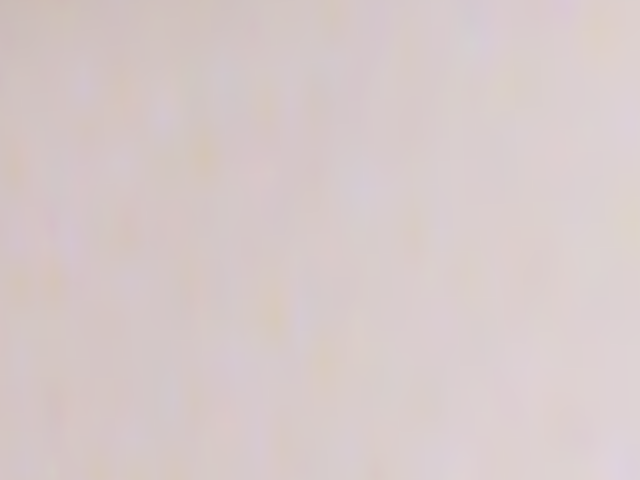

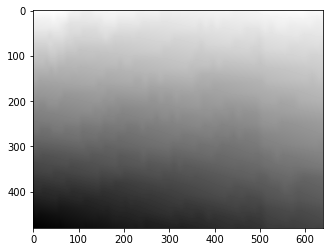

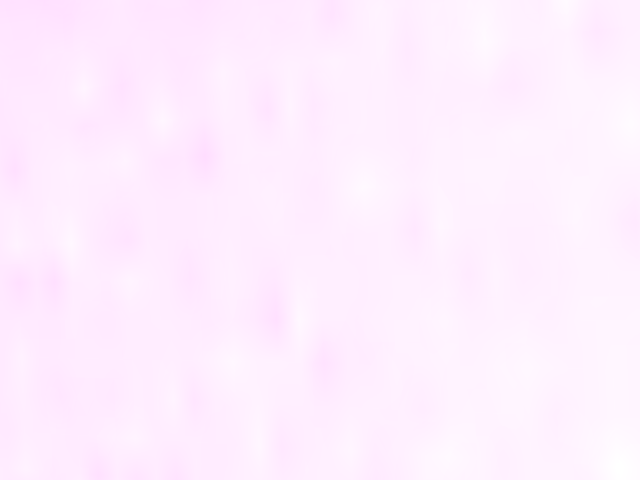

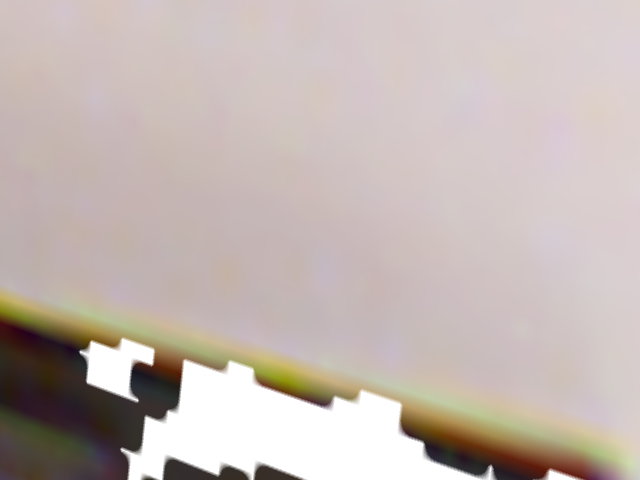

...

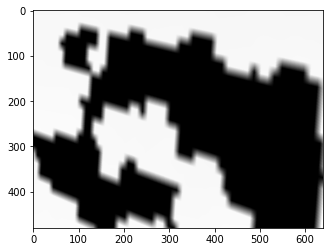

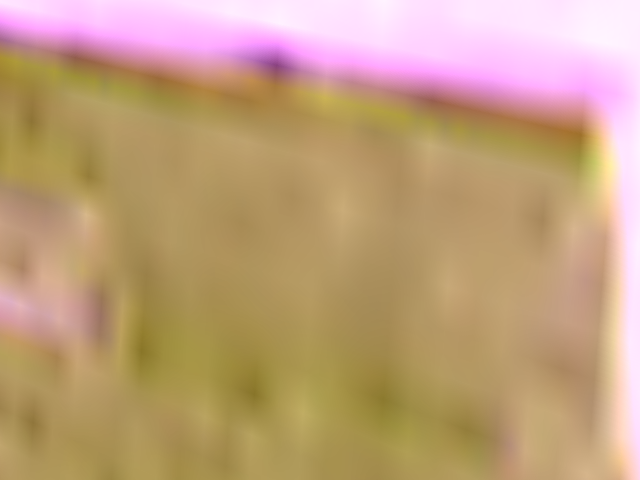

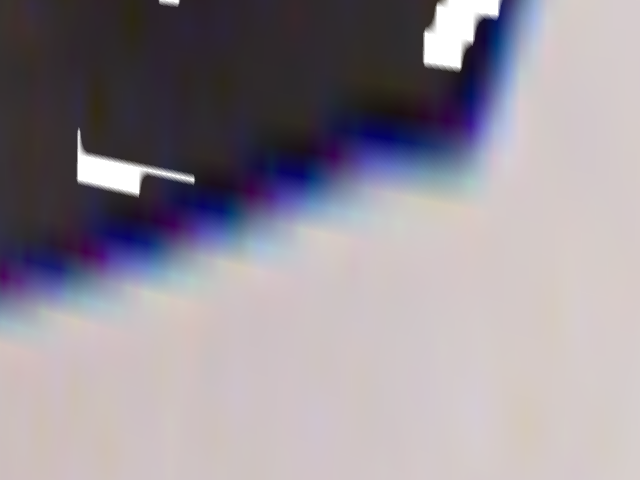

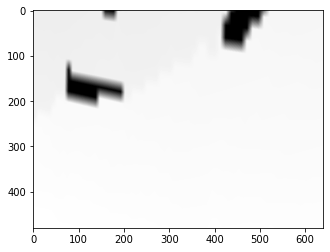

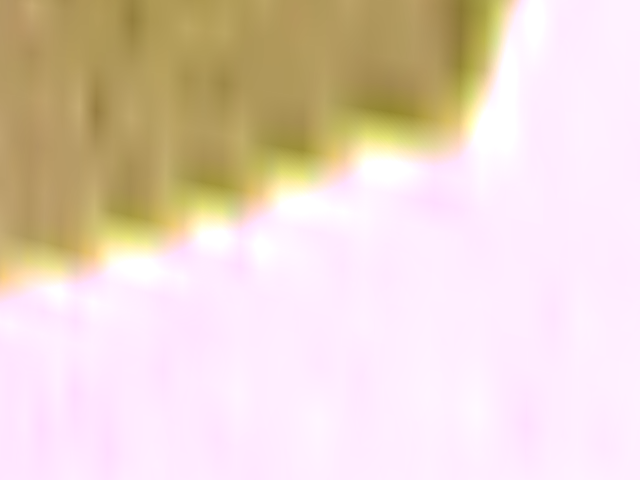

RGB_D (480, 640, 4)


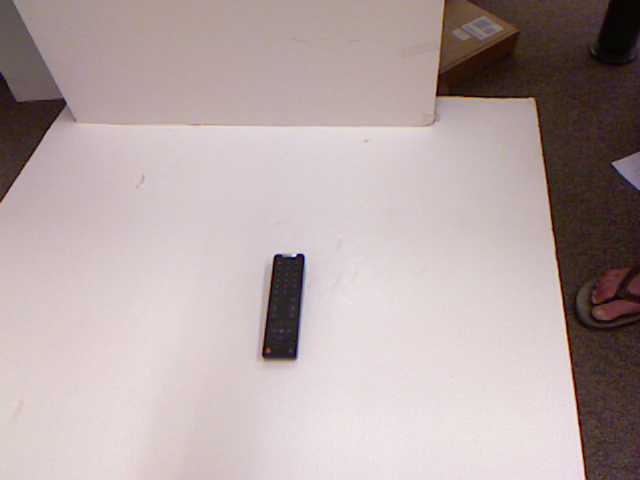

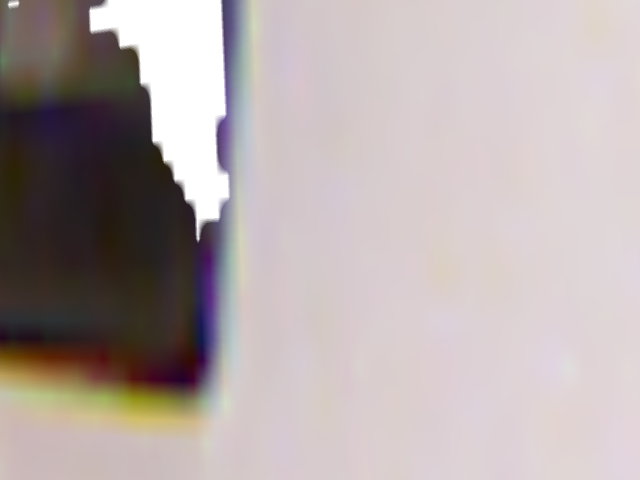

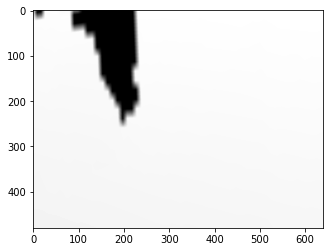

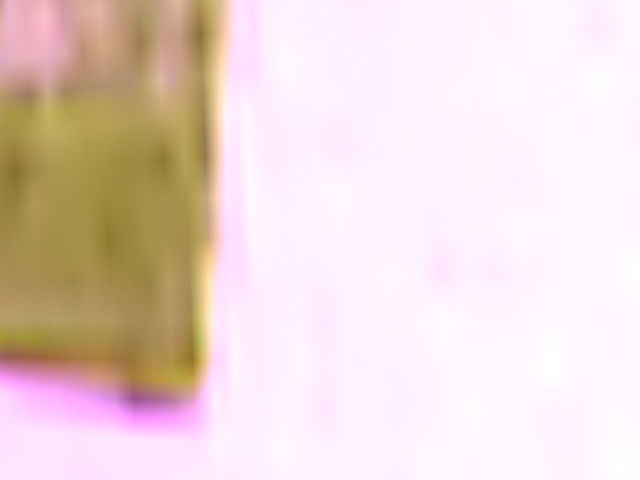

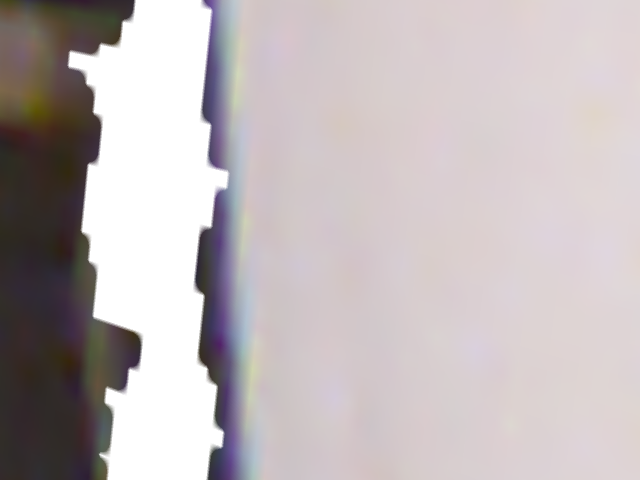

...

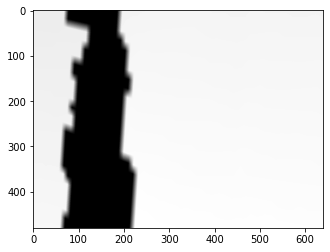

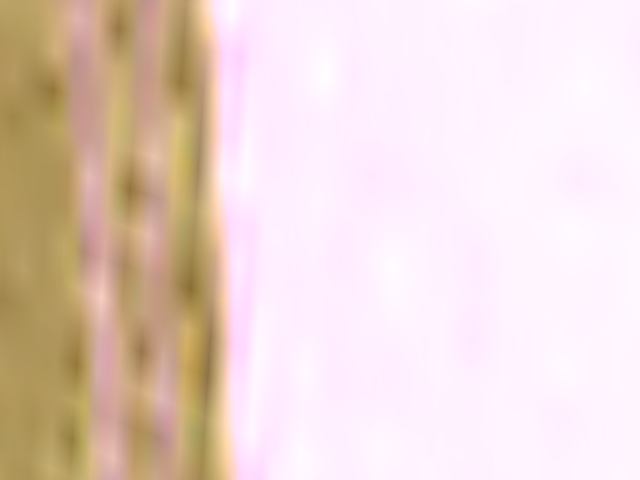

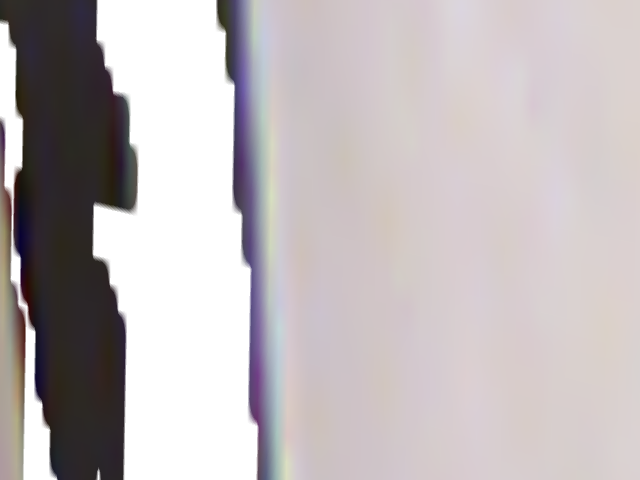

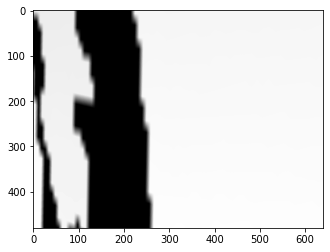

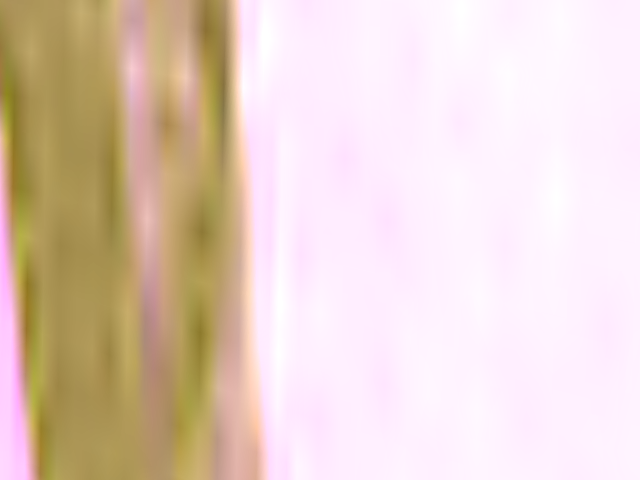

In [ ]:
import cv2  
from google.colab.patches import cv2_imshow
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os

import copy

def YUV(RGB_D):
  directory = r'/content/mnt/MyDrive/Colab Notebooks/592x/Hw2/01/'

  path = []
  pos_path = []
  neg_path = []


  for filename in os.listdir(directory):
    if filename.endswith("100r.png") :
      path.append(os.path.join(directory, filename))

    elif filename.endswith("100cpos.txt") :
      pos_path.append(os.path.join(directory, filename))

    elif filename.endswith("cneg.txt") :
      neg_path.append(os.path.join(directory, filename))



  path = sorted(path)
  print('path',path)
  pos_path = sorted(pos_path)
  print('pos_path',pos_path)
  neg_path = sorted(neg_path)
  #print('neg_path',neg_path[0:5])


  # crop_img[map==1] = img[map==1]




  depth_img = []
  for d in range(len(RGB_D)):
    # print('____________________', np.shape(RGB_D))
    RGB_D_1= RGB_D[d]
    
   # mask = np.zeros((480,640))


  
    
    i = 0 
    z = 0 
    y = 0
    d = 0 

    print('RGB_D', np.shape(RGB_D_1))

    for i in range(len(path)):
      image = cv2.imread(path[i]) 
      cv2_imshow( image) 
      #img_yuv_cv2 = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
      #cv2_imshow(img_yuv_cv2)

      pos_location = pd.read_csv(pos_path[i],header = None, sep=" " ).dropna(axis='columns')

      for z in range(4, len(pos_location)+1,4):
        Vertics = pos_location.iloc[abs(z-4):z].values


       # mask = np.zeros((480,640))
       # crop_img = np.zeros((480,640,4))
        #mask = cv2.fillPoly(mask, np.int32([Vertics]),1)


        #index_mask = np.argwhere(mask == 1)




        # q = 0 
        # p = 0 

        # for q in range(4):
        #   for p in range(len(index_mask)):
        #     #patch[masks[i]] = rgbd_imgs[i][masks[i]]
        #     crop_img[[index_mask[p][0]],[index_mask[p][1]],[q]] = RGB_D[[index_mask[p][0]],[index_mask[p][1]],[q]]

          #rgb_d[True or False ]

          #np.array([pos_location.iloc[0].values, pos_location.iloc[1].values])


        pts1 = np.float32([[0,0],[640,0],[640,640],[0,480]])
        pts2 = np.float32([Vertics])

        M = cv2.getPerspectiveTransform(pts2,pts1)

        crop_img_1 = cv2.warpPerspective(RGB_D_1,M,(640,480))


        #print('crop_img_1', np.shape(crop_img_1))

        cv2_imshow(crop_img_1)
       # print('crop_img_1.shape', crop_img_1.shape)
 
       # print('crop_img_1.shape', crop_img_1.shape)
        plt.imshow(crop_img_1[:, :, 3], cmap=plt.cm.gray)
        plt.show()


        #rows,cols,ch = img.shape

        # plt.subplot(121),plt.imshow(img),plt.title('Input')
        # plt.subplot(122),plt.imshow(dst),plt.title('Output')
        # plt.show()

        depth_img.append(crop_img_1[:, :, 3])
        
     
        cv_2 = RGB_D_1[:, :,:2]
        img_yuv_cv2 = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
        #cv2_imshow(img_yuv_cv2)
        #print('index_mask', crop_img[:,:,:3])

        #print('index_mask', RGB_D)

        # Calculated the Y U V from the resized image 
        Y  =  0.257 *crop_img_1[:,:,2].astype(np.uint8) + 0.504*crop_img_1[:,:,1].astype(np.uint8) + crop_img_1[:,:,0].astype(np.uint8) + 16 

        U =  -0.148 *crop_img_1[:,:,2].astype(np.uint8) -0.291*crop_img_1[:,:,1].astype(np.uint8) + crop_img_1[:,:,0].astype(np.uint8) + 128 

        V  =  0.436 *crop_img_1[:,:,2].astype(np.uint8) - 0.368*crop_img_1[:,:,1].astype(np.uint8) + crop_img_1[:,:,0].astype(np.uint8) + 128 

        #img_yuv = cv2.cvtColor(rr.astype(np.uint8), cv2.COLOR_BGR2YUV)



        img_yuv = np.dstack((Y,U,V))
        cv2_imshow(img_yuv)


  return depth_img

depth_img = YUV(RGB_D)


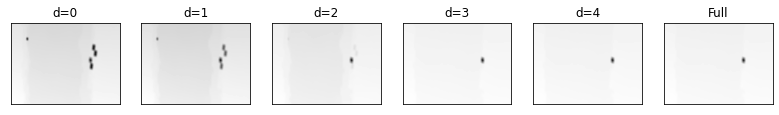

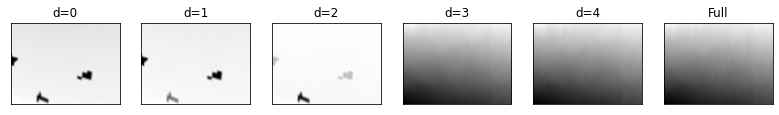

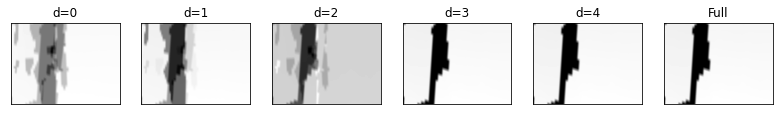

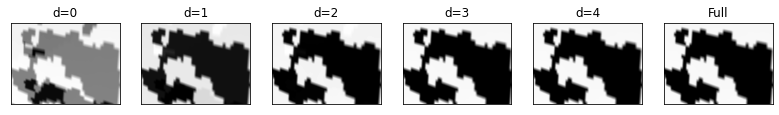

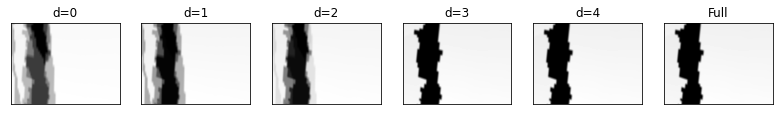

In [ ]:
#Question 4 
# Import libraries
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA



def pca(depth_img,Number):
  # define the shape of the plot also ploting the image 
  def plt_face(x):
      h = 480
      w = 640
      plt.imshow(x.reshape((h, w)), cmap=plt.cm.gray)
      plt.xticks([])
      plt.yticks([])

  e = 0 
  o = 0 
  for i in range(0,len(Number)):

    depth_img_1 = depth_img[o:o+Number[i]]
    o = o+ Number[i]

    n_samples, h, w = np.shape(depth_img_1)
    #print('np.shape(depth_img)',np.shape(depth_img_1))
    Depth = [] 
    for r in range(len(depth_img_1)):
      depth = depth_img_1[r].flatten()
      Depth.append(depth)
    Depth = np.array(Depth)



    # deph = depth_img_1[i]
   # print('deph',Depth)

    X = Depth
    nplt = 1 
    ds = [0,1,2,3,4]  # number of SVD approximations
    use_pca = True         # True=Use sklearn reconstruction, else use SVD

    if use_pca:
        # Construct the PCA object for the max number of coefficient
        dmax = np.max(ds)
        pca = PCA(n_components=dmax, svd_solver='randomized', whiten=True)
        
        # Fit and transform the data
        pca.fit(X)
        Z = pca.transform(X)


    # Fit the PCA components on the entire dataset
    pca.fit(X)

    # Select random faces
    inds = np.random.permutation(n_samples)
    inds = inds[:nplt]
    nd = len(ds)

    # Set figure size
    plt.figure(figsize=(1.8 * (nd+1), 2.4 * nplt))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)

    # Loop over figures
    iplt = 0
    for ind in inds:
        for d in ds:
            plt.subplot(nplt,nd+1,iplt+1)
            if use_pca:
                # Zero out coefficients after d.  
                # Note, we need to copy to not overwrite the coefficients
                Zd = np.copy(Z[ind,:])
                Zd[d:] = 0
                Xhati = pca.inverse_transform(Zd)
            else:
                # Reconstruct with SVD
                Xhati = (U[ind,:d]*S[None,:d]).dot(Vtr[:d,:]) + Xmean
                
            plt_face(Xhati)
            plt.title('d={0:d}'.format(d))
            iplt += 1
        
        # Plot the true face
        plt.subplot(nplt,nd+1,iplt+1)
        plt_face(X[ind,:])
        plt.title('Full')
        iplt += 1


pca(depth_img,Number)



In [ ]:
# Question 5 

#!pip install open3d
​
import os
import open3d as o3d
import numpy as np
​
# first we should rename the .txt files to .pcd (just once)
os.rename(r'data/08/pcd0831.txt',r'data/08/pcd0831.pcd')
​
# Then we can use open3d to visualize it
pcd = o3d.io.read_point_cloud("data/08/pcd0831.pcd")
print(pcd)
print(np.asarray(pcd.points))
